# Opinion dynamics on hypergraphs
The purpose of this notebook is to replicate some of the results in [Iacopini et al. (2022) _Group interactions modulate critical mass dynamics in social convention_](https://doi.org/10.1038/s42005-022-00845-y).  

The model presented here is an opinion dynamics model which lives on hypergraph. We will focus both on synthetic hypergraphs and hypergraphs created from real data.  
  
The code has been adapted and reshaped from the Supplementary Material referenced paper, according to our purposes. 

## Libraries import

In [ ]:
import numpy as np
from numpy import random
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D   
from matplotlib import gridspec
import matplotlib.font_manager as fm
import pandas as pd
import random
import collections
from itertools import combinations
import json

In [ ]:
#setting some parameters for plotting images
plt.rcParams['xtick.major.width'] = 1.2
plt.rcParams['ytick.major.width'] = 1.2
plt.rcParams['xtick.minor.size'] = 2
plt.rcParams['xtick.minor.width'] = 1.2
plt.rcParams['ytick.minor.size'] = 2
plt.rcParams['ytick.minor.width'] = 1.2
plt.rcParams['axes.linewidth'] = 1.2

plt.rcParams['font.family'] = 'Trebuchet MS' # set the font family style
plt.rcParams['pdf.fonttype'] = 42 #text in PDF figures is embedded as text (thus searchable)

#setting the color codes for the agents states
main_colors = ['#c00000', '#2f5597', '#548235'] #these colors are (red, blue, green) corresponding to (A,B,AB) states
light_colors = ['#ff9797', '#b4c7e7', '#c5e0b4']

In [ ]:
#This function stretches a list adding the last element at the end until it reaches the desired length, we'll need it later
def stretch_list(some_list, target_len):
    some_list = list(some_list)
    return some_list[:target_len] + [some_list[-1]]*(target_len - len(some_list))

## Model construction
Here we define the class Model which contains all the functions needed for simulating the intended dynamics. 

In [ ]:
class Model():
    def __init__(self, simplices):
        #Structure
        self.simplices = simplices
        self.nodes = list({node for simplex in simplices for node in simplex}) #it returns the list of unique nodes
        self.N = len(self.nodes)

        #Time
        self.t = 0
    
    def SetInitialConditions(self, beta, p, n_A, verbose=False):
        """
        This function sets the intial conditions.

        :verbose: if True, a string containing set-up details is printed.
        """
        #Params
        self.beta = beta
        self.p = p

        #Nodes' vocabularies (opinions)
        self.opinions = {}

        #Generating the committed minority 
        N_p = int(self.N*self.p) #number of committed individuals
        committed = random.sample(self.nodes, N_p) #random sample to create the committed agents
        for n in self.nodes:
            if n in committed:
                self.opinions[n]=frozenset(["A"]) #the committed individuals do not change their mind
        
        #Computing the size of intial communities
        N_A = int(self.N*n_A)
        N_B = self.N - N_A - N_p

        #Assigning opinions to individual agents 
        opinions_to_assign = ['A']*N_A + ['B']*N_B #create a list of opinions that follows the communities' sizes
        random.shuffle(opinions_to_assign) #shuffle the list
        noncommitted = set(self.nodes)-set(committed) #create a set for the non committed individuals
        for n, o in zip(noncommitted, opinions_to_assign):
            self.opinions[n]=set(o)
        
        #Expliciting the output if requested
        if verbose: print('Setup done.', self.N, 'nodes', "N_A:", N_A, "N_B:", N_B, "N_p:", N_p)

    def AgreeOnSimplex(self, simplex, said_word):
        """
        This function updates the simplex on the agreed word.
        """
        for n in simplex:
            try: #we use try because committed individuals have frozenset and they won't be updated 
                self.opinions[n].clear()
                self.opinions[n].add(said_word)
            except AttributeError: #it was a committed individual
                pass
    
    def ListenersLearnWord(self, listeners, said_word):
        """
        This function add said_word to the listeners' vocabulary.
        """
        for listener in listeners:
            try:
                self.opinions[listener].add(said_word)
            except AttributeError: #it was a committed individual
                pass
    
    def PlayOnSimplex(self, simplex):
        """
        This function simulate the interaction dynamics for a single group.
        """
        #Selecting speaker and listeners at random
        random.shuffle(simplex)
        speaker = simplex[0]
        listeners = simplex[1:]

        #Selecting a random word from the speaker's vocabulary to be said
        said_word = random.choice(list(self.opinions[speaker]))
        words_of_listeners = [self.opinions[listener] for listener in listeners]
        
        #Getting the words of listeners to be used for the agreement
        words_of_listeners_by_rule = set.intersection(*[set(w) for w in words_of_listeners])

        #Trying to agree acoording to the unanimity condition rule
        if (said_word in words_of_listeners_by_rule) and (random.random() <= self.beta):
            self.AgreeOnSimplex(simplex, said_word)
        else:
            self.ListenersLearnWord(listeners, said_word)

    def GetDensities(self):
        """
        This function returns the densities of each community.
        """
        single_opinion_counter = collections.Counter([list(opinions)[0] for opinions in self.opinions.values() if len(opinions)==1])
        n_Ap = single_opinion_counter["A"]/self.N
        n_B = single_opinion_counter["B"]/self.N
        n_AB = 1 - n_Ap - n_B
        return n_Ap, n_B, n_AB
    
    def run(self, path, t_max=100, check_every=10, print_every=1):
        """
        This function models the interaction of agents, updating their states over time. The simulation continues until all agents agree on a single word (consensus) or the maximum time, t_max, is reached.
        
        Args:
            path (str): The path to the directory where simulation density results will be saved.
            t_max (int):The maximum number of time steps (iterations) for the simulation. Defaults to 100.
            check_every (int): The number of iterations between saving simulation density results. Defaults to 10.
            print_every (int): The number of iterations between printing simulation updates. Defaults to 1.
        """
        self.t_max = t_max

        #Opening file to save densities results
        densities_path = path + 'simulation_densities_N%i_beta%.4f_p%.2f.csv'%(self.N, self.beta, self.p)
        f = open(densities_path, 'w')
        f.write('time,n_A+p,n_B,n_AB\n')

        #Running the simulation
        while self.t <= self.t_max:
            self.t += 1
            #Signaling the simulation is still running
            if self.t%print_every==0: print('t=%i'%self.t)
    
            #Selecting a random simplex to be played on
            simplex = random.choice(self.simplices)

            #Playing on simplex
            self.PlayOnSimplex(simplex)
                
            #Storing the values every check_every time steps:
            if self.t%check_every==0:
                n_Ap, n_B, n_AB = self.GetDensities()
                line = "%i,%.3f,%.3f,%.3f\n"%(self.t, n_Ap, n_B, n_AB)
                f.write(line)
                
                #Checking if we reached the absorbing state in order to interrupt the simulation:
                if n_Ap==1 or n_B==1:
                    f.close()   
                    print('Done! Reached the absorbing state.')
                    return None
                
        f.close()    
        print('Done! No more time left')
    
    def ReturnFilepath(self, path):
        results_filepath = path + 'simulation_densities_N%i_beta%.4f_p%.2f.csv'%(self.N, self.beta, self.p)
        return results_filepath

## Test on a toy hypergraph
Let's test the model on a toy hypergraph, made by our hands.

In [21]:
simplices = [[1,2,3], [2,4,6], [3,2,7], [4,8,9,2]]

beta = 0.3
p = 0.4
n_A = 0

output_path = "./Simulation_Results/Toy_Hypergraph/"
t_max = 1000

check_every = 1

simulation = Model(simplices)
simulation.SetInitialConditions(beta, p, n_A, verbose=True)
simulation.run(output_path, t_max, check_every)

Setup done. 8 nodes N_A: 0 N_B: 5 N_p: 3
t=1
t=2
t=3
t=4
t=5
t=6
t=7
t=8
t=9
t=10
t=11
t=12
t=13
t=14
t=15
t=16
t=17
t=18
t=19
t=20
t=21
t=22
t=23
t=24
t=25
t=26
t=27
t=28
t=29
t=30
t=31
t=32
t=33
t=34
t=35
t=36
t=37
t=38
t=39
t=40
t=41
t=42
t=43
t=44
t=45
t=46
t=47
t=48
t=49
t=50
t=51
t=52
t=53
t=54
t=55
t=56
t=57
t=58
t=59
t=60
Done! Reached the absorbing state.


In [22]:
results_filepath = simulation.ReturnFilepath(output_path)
df = pd.read_csv(results_filepath)

<Axes: xlabel='time'>

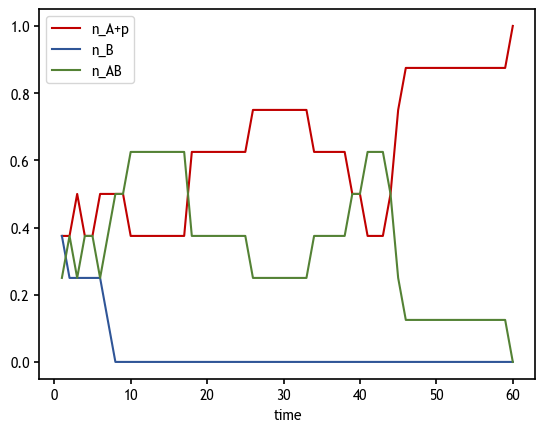

In [23]:
df.plot(x='time', color=main_colors)

## Run on a homogenous mixing $k$-hypergraph
We now test the model on an uniform $k$-hypergraph which we build in such a way that all possible combinations of $(k-1)$-interactions are considered (homogenous mixing).  
  
As before, the hypergraph is initialized, the simulation is run and the results plotted. The code for generating a GIF for such dynamics is put in _'GIF_code.ipynb'_ notebook.

In [12]:
def k_hypergraph_creator(N,k=3):
    nodes = range(N)
    simplices = list(combinations(nodes,k)) #generates all possible combination made by k nodes
    simplices = [list(simplex) for simplex in simplices]
    return simplices

In [13]:
N = 100
k = 3
simplices = k_hypergraph_creator(N,k)

In [14]:
beta = 0.3
p = 0.03
n_A = 0

output_path = "./Simulation_Results/HomMix_Hypergraph/"
t_max = 1e5

check_every = 1

simulation = Model(simplices)
simulation.SetInitialConditions(beta, p, n_A, verbose=True)
simulation.run(output_path, t_max, check_every)

Setup done. 100 nodes N_A: 0 N_B: 97 N_p: 3
t=1
t=2
t=3
t=4
t=5
t=6
t=7
t=8
t=9
t=10
t=11
t=12
t=13
t=14
t=15
t=16
t=17
t=18
t=19
t=20
t=21
t=22
t=23
t=24
t=25
t=26
t=27
t=28
t=29
t=30
t=31
t=32
t=33
t=34
t=35
t=36
t=37
t=38
t=39
t=40
t=41
t=42
t=43
t=44
t=45
t=46
t=47
t=48
t=49
t=50
t=51
t=52
t=53
t=54
t=55
t=56
t=57
t=58
t=59
t=60
t=61
t=62
t=63
t=64
t=65
t=66
t=67
t=68
t=69
t=70
t=71
t=72
t=73
t=74
t=75
t=76
t=77
t=78
t=79
t=80
t=81
t=82
t=83
t=84
t=85
t=86
t=87
t=88
t=89
t=90
t=91
t=92
t=93
t=94
t=95
t=96
t=97
t=98
t=99
t=100
t=101
t=102
t=103
t=104
t=105
t=106
t=107
t=108
t=109
t=110
t=111
t=112
t=113
t=114
t=115
t=116
t=117
t=118
t=119
t=120
t=121
t=122
t=123
t=124
t=125
t=126
t=127
t=128
t=129
t=130
t=131
t=132
t=133
t=134
t=135
t=136
t=137
t=138
t=139
t=140
t=141
t=142
t=143
t=144
t=145
t=146
t=147
t=148
t=149
t=150
t=151
t=152
t=153
t=154
t=155
t=156
t=157
t=158
t=159
t=160
t=161
t=162
t=163
t=164
t=165
t=166
t=167
t=168
t=169
t=170
t=171
t=172
t=173
t=174
t=175
t=176
t=177
t=

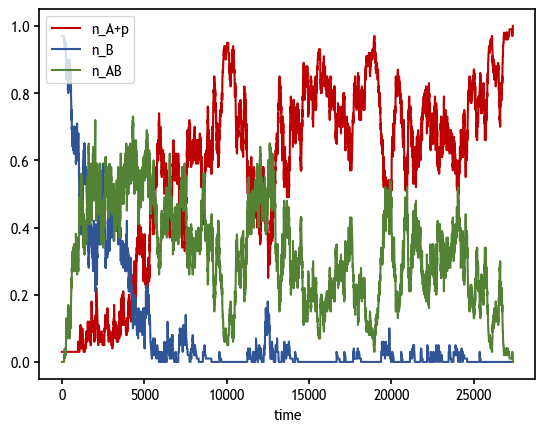

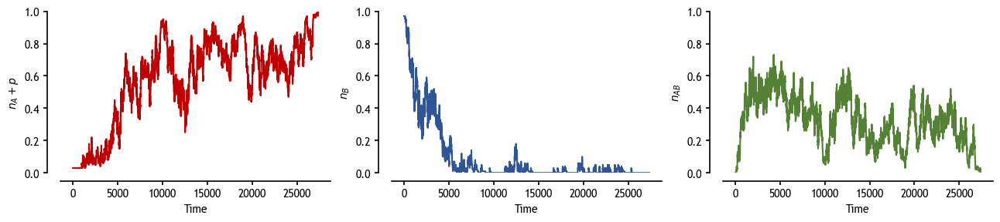

In [ ]:
results_filepath = simulation.ReturnFilepath(output_path)
df = pd.read_csv(results_filepath)
df.plot(x='time', color=main_colors)

################## Dividing in three subplots to make it more readable ##################

fig, ax=plt.subplots(1,3, figsize=(13,3))
ylabels_df=['n_A+p', 'n_B', 'n_AB']
ylabels=['n_A+p', 'n_B', 'n_{AB}']
for i in [0,1,2]:
    ax[i].plot(df['time'], df[ylabels_df[i]], color=main_colors[i])
    ax[i].set_ylim(0,1)
    ax[i].set_xlabel('Time')
    ax[i].set_ylabel(rf'${ylabels[i]}$')

#################################### Adjusting ticks #################################### 
for i in [0,1,2]:
    ax[i].spines['right'].set_color('none')
    ax[i].spines['top'].set_color('none')
    ax[i].xaxis.set_ticks_position('bottom')

    ax[i].spines['bottom'].set_position(('axes', -0.05))
    ax[i].yaxis.set_ticks_position('left')
    ax[i].spines['left'].set_position(('axes', -0.05))
            
plt.tight_layout()
plt.show()


## Run on a real hypergraph
We now move to a hypergraph created from real data. Let's start by importing the data! 

In [18]:
dataset = 'Thiers13'

In [19]:
dataset_dir = './Data/Sociopatterns/Processed_data/'
n_minutes = 15
thr = 1

filename = dataset_dir+'aggr_'+str(n_minutes)+'min_cliques_thr'+str(thr)+'_'+dataset+'.json'
simplices = json.load(open(filename,'r'))

Let's run the model once, to see if everything works as intended.

In [20]:
beta = 0.2759
p = 0.03
n_A = 0

output_path = "./Simulation_Results/Sociopatterns/"
t_max = 1e6

check_every = 500
print_every = 50000

simulation = Model(simplices)
simulation.SetInitialConditions(beta, p, n_A, verbose=True)
simulation.run(output_path, t_max, check_every)

Setup done. 327 nodes N_A: 0 N_B: 318 N_p: 9
t=1
t=2
t=3
t=4
t=5
t=6
t=7
t=8
t=9
t=10
t=11
t=12
t=13
t=14
t=15
t=16
t=17
t=18
t=19
t=20
t=21
t=22
t=23
t=24
t=25
t=26
t=27
t=28
t=29
t=30
t=31
t=32
t=33
t=34
t=35
t=36
t=37
t=38
t=39
t=40
t=41
t=42
t=43
t=44
t=45
t=46
t=47
t=48
t=49
t=50
t=51
t=52
t=53
t=54
t=55
t=56
t=57
t=58
t=59
t=60
t=61
t=62
t=63
t=64
t=65
t=66
t=67
t=68
t=69
t=70
t=71
t=72
t=73
t=74
t=75
t=76
t=77
t=78
t=79
t=80
t=81
t=82
t=83
t=84
t=85
t=86
t=87
t=88
t=89
t=90
t=91
t=92
t=93
t=94
t=95
t=96
t=97
t=98
t=99
t=100
t=101
t=102
t=103
t=104
t=105
t=106
t=107
t=108
t=109
t=110
t=111
t=112
t=113
t=114
t=115
t=116
t=117
t=118
t=119
t=120
t=121
t=122
t=123
t=124
t=125
t=126
t=127
t=128
t=129
t=130
t=131
t=132
t=133
t=134
t=135
t=136
t=137
t=138
t=139
t=140
t=141
t=142
t=143
t=144
t=145
t=146
t=147
t=148
t=149
t=150
t=151
t=152
t=153
t=154
t=155
t=156
t=157
t=158
t=159
t=160
t=161
t=162
t=163
t=164
t=165
t=166
t=167
t=168
t=169
t=170
t=171
t=172
t=173
t=174
t=175
t=176
t=177
t

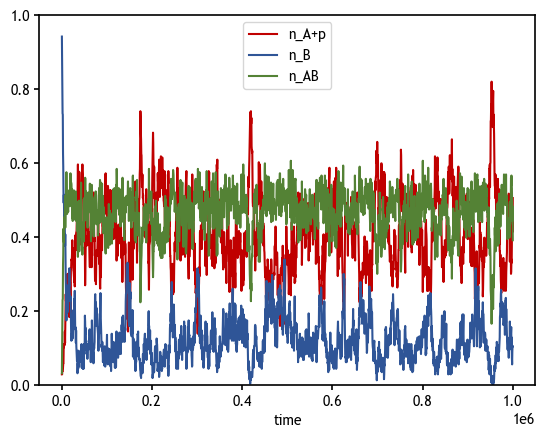

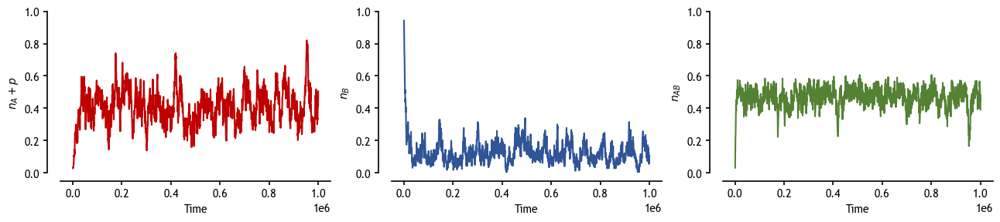

In [21]:
results_filepath=simulation.ReturnFilepath(output_path)
df=pd.read_csv(results_filepath)

df.plot(x='time', color=main_colors)
plt.ylim(0,1)

################## Dividing in three subplots to make it more readable ##################

fig, ax=plt.subplots(1,3, figsize=(13,3))
ylabels_df=['n_A+p', 'n_B', 'n_AB']
ylabels=['n_A+p', 'n_B', 'n_{AB}']
for i in [0,1,2]:
    ax[i].plot(df['time'], df[ylabels_df[i]], color=main_colors[i])
    ax[i].set_ylim(0,1)
    ax[i].set_xlabel('Time')
    ax[i].set_ylabel(rf'${ylabels[i]}$')

#################################### Adjusting ticks #################################### 
for i in [0,1,2]:
    ax[i].spines['right'].set_color('none')
    ax[i].spines['top'].set_color('none')
    ax[i].xaxis.set_ticks_position('bottom')

    ax[i].spines['bottom'].set_position(('axes', -0.05))
    ax[i].yaxis.set_ticks_position('left')
    ax[i].spines['left'].set_position(('axes', -0.05))
            
plt.tight_layout()
plt.show()

<span style="color: white; background-color: red; padding: 5px; font-weight: bold"> DO NOT RUN the following code UNLESS you've run MultipleRuns_fixed_p.ipynb (long) or you already got the data coming from there.</span>  
  
As multiple runs take quite a while to complete, they have been executed on the external notebook _'MultipleRuns_fixed_p.ipynb'_ and results have been saved on .csv files that we recover here.

### Temporal evolution for different $\beta s$
We plot the averaged temporal evolution for three different values of the parameter $\beta$ (50 runs each) and fixed $p$.

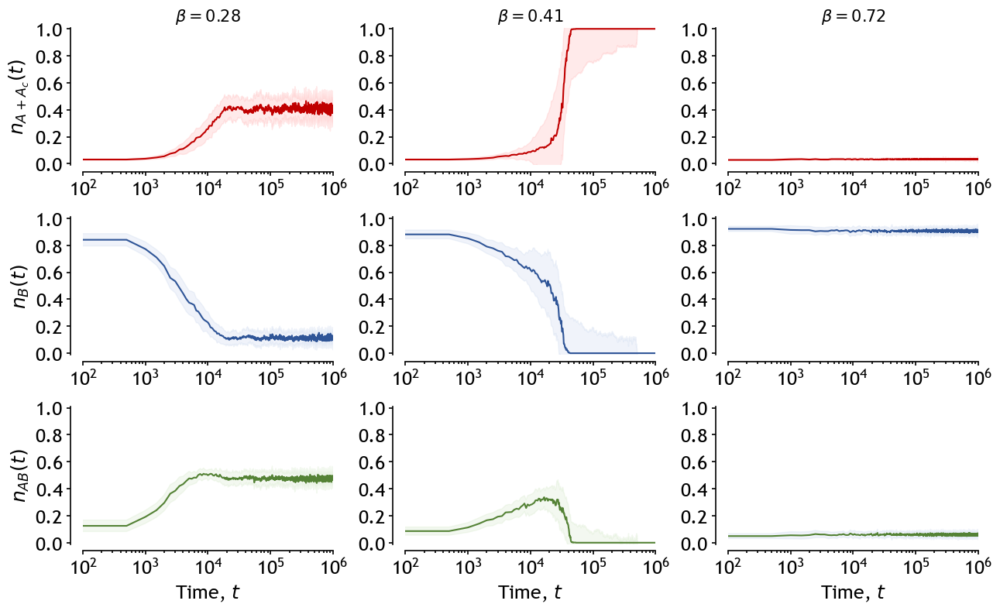

In [ ]:
p=0.03
n_runs = 50

time = np.arange(0, 1e6+500, 500)
fig, ax = plt.subplots(3,3, figsize=(13,8))

##############################################################################

beta = 0.2759 #1st value of beta

#taking the densities evolution for each run
tensor_A, tensor_AB, tensor_B = [], [], []       
for run_id in range(n_runs):
    fname = './Simulation_Results/Sociopatterns/%s_fixed_p%.2f_varbeta_run%i/simulation_densities_N327_beta%.4f_p%.2f.csv'%(dataset, p, run_id, beta, p)
    df = pd.read_csv(fname)

    #adding values after absorbing state
    if len(df)<2001:
        tensor_A.append(stretch_list(df['n_A+p'].values, 2001))
        tensor_B.append(stretch_list(df['n_B'].values, 2001))
        tensor_AB.append(stretch_list(df['n_AB'].values, 2001))
    else:
        tensor_A.append(df['n_A+p'].values)
        tensor_B.append(df['n_B'].values)
        tensor_AB.append(df['n_AB'].values)

#converting the densities lists into NumPy arrays
tensor_A = np.array(tensor_A)
tensor_B = np.array(tensor_B)
tensor_AB = np.array(tensor_AB)
#averaging the densities at each time-step across the runs 
med_tensor_A = np.median(tensor_A, axis=0)
med_tensor_B = np.median(tensor_B, axis=0)
med_tensor_AB = np.median(tensor_AB, axis=0)
#computing the standard deviation at each time-step across the runs
std_tensor_A = np.std(tensor_A, axis=0)
std_tensor_B = np.std(tensor_B, axis=0)
std_tensor_AB = np.std(tensor_AB, axis=0)

#plotting the results
ax[0][0].plot(time, med_tensor_A, color=main_colors[0])
ax[0][0].fill_between(time, med_tensor_A-std_tensor_A, med_tensor_A+std_tensor_A, color=light_colors[0], alpha=0.2, zorder=0)
ax[1][0].plot(time, med_tensor_B, color=main_colors[1])
ax[1][0].fill_between(time, med_tensor_B-std_tensor_B, med_tensor_B+std_tensor_B, color=light_colors[1], alpha=0.2, zorder=0)
ax[2][0].plot(time, med_tensor_AB, color=main_colors[2])
ax[2][0].fill_between(time, med_tensor_AB-std_tensor_AB, med_tensor_AB+std_tensor_AB, color=light_colors[2], alpha=0.2, zorder=0)

##############################################################################
    
beta = 0.4138 #2nd value

tensor_A, tensor_B, tensor_AB = [], [], []       
for run_id in range(n_runs):
    fname = './Simulation_Results/Sociopatterns/%s_fixed_p%.2f_varbeta_run%i/simulation_densities_N327_beta%.4f_p%.2f.csv'%(dataset, p, run_id, beta, p)
    df = pd.read_csv(fname)

    if len(df)<2001:
        tensor_A.append(stretch_list(df['n_A+p'].values, 2001))
        tensor_B.append(stretch_list(df['n_B'].values, 2001))
        tensor_AB.append(stretch_list(df['n_AB'].values, 2001))
    else:
        tensor_A.append(df['n_A+p'].values)
        tensor_AB.append(df['n_AB'].values)
        tensor_B.append(df['n_B'].values)

tensor_A = np.array(tensor_A)
tensor_B = np.array(tensor_B)
tensor_AB = np.array(tensor_AB)
med_tensor_A = np.median(tensor_A, axis=0)
med_tensor_B = np.median(tensor_B, axis=0)
med_tensor_AB = np.median(tensor_AB, axis=0)
std_tensor_A = np.std(tensor_A, axis=0)
std_tensor_B = np.std(tensor_B, axis=0)
std_tensor_AB = np.std(tensor_AB, axis=0)

ax[0][1].plot(time, med_tensor_A, color=main_colors[0])
ax[0][1].fill_between(time, med_tensor_A-std_tensor_A, med_tensor_A+std_tensor_A, color=light_colors[0], alpha=0.2, zorder=0)
ax[1][1].plot(time, med_tensor_B, color=main_colors[1])
ax[1][1].fill_between(time, med_tensor_B-std_tensor_B, med_tensor_B+std_tensor_B, color=light_colors[1], alpha=0.2, zorder=0)
ax[2][1].plot(time, med_tensor_AB, color=main_colors[2])
ax[2][1].fill_between(time, med_tensor_AB-std_tensor_AB, med_tensor_AB+std_tensor_AB, color=light_colors[2], alpha=0.2, zorder=0)

##############################################################################    

beta = 0.7241 #3rd value

tensor_A, tensor_AB, tensor_B = [], [], []       
for run_id in range(n_runs):
    fname = './Simulation_Results/Sociopatterns/%s_fixed_p%.2f_varbeta_run%i/simulation_densities_N327_beta%.4f_p%.2f.csv'%(dataset, p, run_id, beta, p)
    df = pd.read_csv(fname)

    if len(df)<2001:
        tensor_A.append(stretch_list(df['n_A+p'].values, 2001))
        tensor_B.append(stretch_list(df['n_B'].values, 2001))
        tensor_AB.append(stretch_list(df['n_AB'].values, 2001))
    else:
        tensor_A.append(df['n_A+p'].values)
        tensor_B.append(df['n_B'].values)
        tensor_AB.append(df['n_AB'].values)

tensor_A = np.array(tensor_A)
tensor_B = np.array(tensor_B)
tensor_AB = np.array(tensor_AB)
med_tensor_A = np.median(tensor_A, axis=0)
med_tensor_B = np.median(tensor_B, axis=0)
med_tensor_AB = np.median(tensor_AB, axis=0)
std_tensor_A = np.std(tensor_A, axis=0)
std_tensor_B = np.std(tensor_B, axis=0)
std_tensor_AB = np.std(tensor_AB, axis=0)

ax[0][2].plot(time, med_tensor_A, color=main_colors[0])
ax[0][2].fill_between(time, med_tensor_A-std_tensor_A, med_tensor_A+std_tensor_A, color=light_colors[0], alpha=0.2, zorder=0)
ax[1][2].plot(time, med_tensor_B, color=main_colors[1])
ax[1][2].fill_between(time, med_tensor_B-std_tensor_B, med_tensor_B+std_tensor_B, color=light_colors[1], alpha=0.2, zorder=0)
ax[2][2].plot(time, med_tensor_AB, color=main_colors[2])
ax[2][2].fill_between(time, med_tensor_AB-std_tensor_AB, med_tensor_AB+std_tensor_AB, color=light_colors[1], alpha=0.2, zorder=0)

##############################################################################    
  
ax[2][0].set_xlabel(r'Time, $t$', size=18)
ax[2][1].set_xlabel(r'Time, $t$', size=18)
ax[2][2].set_xlabel(r'Time, $t$', size=18)
ax[0][0].set_ylabel(r'$n_{A+A_c}(t)$', size=18)  
ax[1][0].set_ylabel(r'$n_{B}(t)$', size=18)
ax[2][0].set_ylabel(r'$n_{AB}(t)$', size=18)  
  
for ii in [0,1,2]:
    for jj in [0,1,2]:
        ax[ii][jj].set_xscale('log')
        ax[ii][jj].set_xlim(1e2, 1e6)
        ax[ii][jj].set_yticks([0,0.2,0.4,0.6,0.8,1])
        ax[ii][jj].set_ylim(-0.01, +1.01)
        ax[ii][jj].tick_params(axis='both', which='major', labelsize=18)

ax[0][0].set_title(r'$\beta=%.2f$'%0.2759, size=15)
ax[0][1].set_title(r'$\beta=%.2f$'%0.4138, size=15)
ax[0][2].set_title(r'$\beta=%.2f$'%0.7241, size=15)
    
      
#################################### Adjusting ticks #################################### 
for ii in [0,1,2]:
    for jj in [0,1,2]:
        ax[ii,jj].spines['right'].set_color('none')
        ax[ii,jj].spines['top'].set_color('none')
        ax[ii,jj].xaxis.set_ticks_position('bottom')

        ax[ii,jj].spines['bottom'].set_position(('axes', -0.05))
        ax[ii,jj].yaxis.set_ticks_position('left')
        ax[ii,jj].spines['left'].set_position(('axes', -0.05))
            
plt.tight_layout()

filename = "./Figures/time_evolution_%s_three_betas_p%.2f.pdf"%(dataset, p)
plt.savefig(filename, bbox_inches='tight', dpi=300, transparent=True)

### Stationary states as a function of $\beta$

We first need to extract the stationary values for each run and $\beta$. Let's also do it for three values of $p$.

In [ ]:
betas = np.linspace(0.,1,30) 
ps = [0, 0.01, 0.03] 

t_max = 1e6
n_runs = 50

for p in ps:
    for run_id in range(n_runs):
        indir = './Simulation_Results/Sociopatterns/%s_fixed_p%.2f_varbeta_run%i/'%(dataset, p, run_id)
        
        last_k_values = 200 #for average
        
        #preparing output file
        f = open(indir+'summary.csv','w')
        f.write('beta,avg_n_A+p,std_n_A+p,avg_n_B,std_n_B,avg_n_AB,std_n_AB\n')

        for beta in betas:
            #reading file
            df = pd.read_csv(indir+'simulation_densities_N327_beta%.4f_p%.2f.csv'%(beta, p))

            #checking if simulation reached an absorbing state
            if (df.tail(1)['time'].values[0]==t_max)or(df.tail(1)['n_A+p'].values[0]==0)or(df.tail(1)['n_A+p'].values[0]==1): #yes
                n_Ap = df.tail(1)['n_A+p'].values[0]
                n_B = df.tail(1)['n_B'].values[0]
                n_AB = df.tail(1)['n_AB'].values[0]
                line = str(beta)+','+str(n_Ap)+','+'0'+','+str(n_B)+','+'0'+','+str(n_AB)+','+'0'+'\n'
                f.write(line)
            else: #getting stationary values
                avgdf = df.tail(last_k_values).mean()
                stddf = df.tail(last_k_values).std()

                avg_n_Ap = avgdf['n_A+p'].values[0]
                avg_n_B = avgdf['n_B'].values[0]
                avg_n_AB = avgdf['n_AB'].values[0]
                std_n_Ap = stddf['n_A+p'].values[0]
                std_n_B = stddf['n_B'].values[0]
                std_n_AB = stddf['n_AB'].values[0]

                line = str(beta)+','+str(avg_n_Ap)+','+str(std_n_Ap)+','+str(n_B)+','+str(std_n_B)+','+str(n_AB)+','+str(std_n_AB)+'\n'
                f.write(line)

        f.close()

We can now take the averages across the runs and plot them.

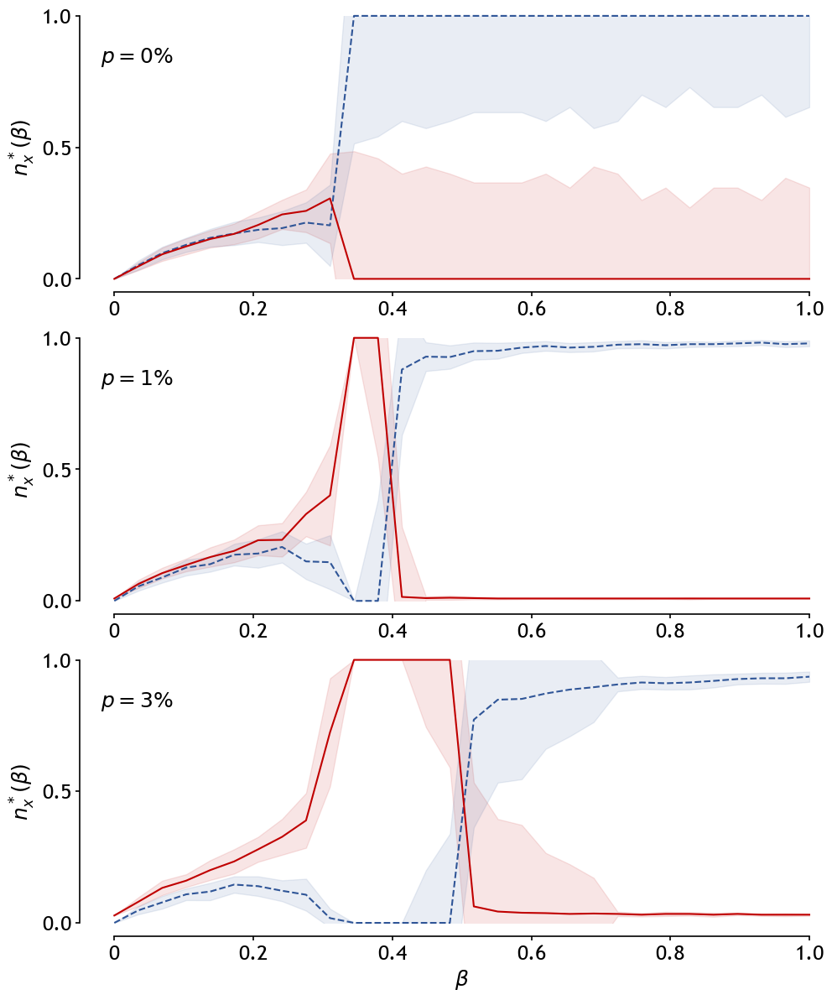

In [ ]:
plt.figure(figsize=(10,12)) 
gs = gridspec.GridSpec(nrows=3, ncols=1, height_ratios=[1,1,1]) 

######################################################################

p = 0

ax = plt.subplot(gs[0])     
tensor = []

for run_id in range(n_runs):
    fname = './Simulation_Results/Sociopatterns/%s_fixed_p%.2f_varbeta_run%i/summary.csv'%(dataset, p, run_id)
    df = pd.read_csv(fname)
    tensor.append(df.to_numpy())
        
#Taking the average from simulations and plotting it
tensor = np.array(tensor)
med_tensor = np.median(tensor, axis=0)
std_tensor = np.std(tensor, axis=0)
med_df = pd.DataFrame(med_tensor, columns=['beta','avg_n_A+p','std_n_A+p','avg_n_B','std_n_B','avg_n_AB','std_n_AB'])
std_df = pd.DataFrame(std_tensor, columns=['beta','avg_n_A+p','std_n_A+p','avg_n_B','std_n_B','avg_n_AB','std_n_AB'])
ax.plot(med_df['beta'], med_df['avg_n_A+p'], '-', mfc='None', color=main_colors[0], mec=main_colors[0], zorder=2, mew=1.5, clip_on=False)
ax.plot(med_df['beta'], med_df['avg_n_B'], '--', ms=8, mfc='None', color=main_colors[1], mec=main_colors[1], zorder=1, mew=1.2, clip_on=False)
ax.fill_between(med_df['beta'], med_df['avg_n_A+p']-std_df['avg_n_A+p'], med_df['avg_n_A+p']+std_df['avg_n_A+p'], color=main_colors[0], alpha=0.1, zorder=0)
ax.fill_between(med_df['beta'], med_df['avg_n_B']-std_df['avg_n_B'], med_df['avg_n_B']+std_df['avg_n_B'], color=main_colors[1], alpha=0.1, zorder=0)

ax.set_xlim(0, 1)
ax.set_xticks([0,0.2,0.4,0.6,0.8,1.0])
ax.set_xticklabels([0,0.2,0.4,0.6,0.8,1.0])
ax.set_ylabel(r'$n_x^*(\beta)$', size=18)
ax.set_ylim(0,1)

ax.tick_params(axis='both', which='major', labelsize=18)
ax.set_yticks([0,0.5,1])

ax.annotate(r'$p=0\%$', xy=(-0.02, 0.82), xycoords="axes fraction", fontsize=18)
    
######################################################################

p = 0.01

ax = plt.subplot(gs[1])     
tensor = []

for run_id in range(n_runs):
    fname = './Simulation_Results/Sociopatterns/%s_fixed_p%.2f_varbeta_run%i/summary.csv'%(dataset, p, run_id)
    df = pd.read_csv(fname)
    tensor.append(df.to_numpy())
        
tensor = np.array(tensor)
med_tensor = np.median(tensor, axis=0)
std_tensor = np.std(tensor, axis=0)
med_df = pd.DataFrame(med_tensor, columns=['beta','avg_n_A+p','std_n_A+p','avg_n_B','std_n_B','avg_n_AB','std_n_AB'])
std_df = pd.DataFrame(std_tensor, columns=['beta','avg_n_A+p','std_n_A+p','avg_n_B','std_n_B','avg_n_AB','std_n_AB'])
ax.plot(med_df['beta'], med_df['avg_n_A+p'], '-', mfc='None', color=main_colors[0], mec=main_colors[0], zorder=2, mew=1.5, clip_on=False)
ax.plot(med_df['beta'], med_df['avg_n_B'], '--', ms=8, mfc='None', color=main_colors[1], mec=main_colors[1], zorder=1, mew=1.2, clip_on=False)
ax.fill_between(med_df['beta'], med_df['avg_n_A+p']-std_df['avg_n_A+p'], med_df['avg_n_A+p']+std_df['avg_n_A+p'], color=main_colors[0], alpha=0.1, zorder=0)
ax.fill_between(med_df['beta'], med_df['avg_n_B']-std_df['avg_n_B'], med_df['avg_n_B']+std_df['avg_n_B'], color=main_colors[1], alpha=0.1, zorder=0)

ax.set_xlim(0, 1)
ax.set_xticks([0,0.2,0.4,0.6,0.8,1.0])
ax.set_xticklabels([0,0.2,0.4,0.6,0.8,1.0])
ax.set_ylabel(r'$n_x^*(\beta)$', size=18)
ax.set_ylim(0,1)

ax.tick_params(axis='both', which='major', labelsize=18)
ax.set_yticks([0,0.5,1])

ax.annotate(r'$p=1\%$', xy=(-0.02, 0.82), xycoords="axes fraction", fontsize=18)
    
######################################################################
p = 0.03
ax = plt.subplot(gs[2])     
tensor = []

for run_id in range(n_runs):
    fname = './Simulation_Results/Sociopatterns/%s_fixed_p%.2f_varbeta_run%i/summary.csv'%(dataset, p, run_id)
    df = pd.read_csv(fname)
    tensor.append(df.to_numpy())
        
tensor = np.array(tensor)
med_tensor = np.median(tensor, axis=0)
std_tensor = np.std(tensor, axis=0)
med_df = pd.DataFrame(med_tensor, columns=['beta','avg_n_A+p','std_n_A+p','avg_n_B','std_n_B','avg_n_AB','std_n_AB'])
std_df = pd.DataFrame(std_tensor, columns=['beta','avg_n_A+p','std_n_A+p','avg_n_B','std_n_B','avg_n_AB','std_n_AB'])
ax.plot(med_df['beta'], med_df['avg_n_A+p'], '-', mfc='None', color=main_colors[0], mec=main_colors[0], zorder=2, mew=1.5, clip_on=False)
ax.plot(med_df['beta'], med_df['avg_n_B'], '--', ms=8, mfc='None', color=main_colors[1], mec=main_colors[1], zorder=1, mew=1.2, clip_on=False)
ax.fill_between(med_df['beta'], med_df['avg_n_A+p']-std_df['avg_n_A+p'], med_df['avg_n_A+p']+std_df['avg_n_A+p'], color=main_colors[0], alpha=0.1, zorder=0)
ax.fill_between(med_df['beta'], med_df['avg_n_B']-std_df['avg_n_B'], med_df['avg_n_B']+std_df['avg_n_B'], color=main_colors[1], alpha=0.1, zorder=0)

ax.set_xlim(0, 1)
ax.set_xticks([0,0.2,0.4,0.6,0.8,1.0])
ax.set_xticklabels([0,0.2,0.4,0.6,0.8,1.0])
ax.set_xlabel(r'$\beta$', size=18)
ax.set_ylabel(r'$n_x^*(\beta)$', size=18)
ax.set_ylim(0,1)
ax.tick_params(axis='both', which='major', labelsize=18)
ax.set_yticks([0,0.5,1])

ax.annotate(r'$p=3\%$', xy=(-0.02, 0.82), xycoords="axes fraction", fontsize=18)

for i in [0,1,2]:
    ax = plt.subplot(gs[i]) 
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.xaxis.set_ticks_position('bottom')
    ax.spines['bottom'].set_position(('axes', -0.05))
    ax.yaxis.set_ticks_position('left')
    ax.spines['left'].set_position(('axes', -0.05))

plt.tight_layout()
filename = "./Figures/stationarystates.pdf"
plt.savefig(filename, bbox_inches='tight', dpi=300)